In [1]:
# Will reload modeules after this when they change!
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import numpy as np
import os
from IPython.display import Image

# Standard plotly imports
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode

# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

# Seaborn
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Matplotlib
import matplotlib.pyplot as plt
from matplotlib_venn import venn3

# Surpress umap errors
import warnings
from exploratory_data_analysis_II import *

def action_with_warnings():
    warnings.warn("should not appear")

### This script 
This script takes the dataframes for experimental samples, and examines the data and metadata.  As well, this script "unstacks" the hmdb_ids column to generate the "observed" dataframe of IDs versus datasets.

# Loads pickles from:
http://localhost:8888/notebooks/PycharmProjects/neutral_loss/nl_0_3_clean_join_nb.ipynb

In [3]:
data_df = pd.read_pickle('high_quality_cm3.pickle')
db_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/core_metabolome_out.pickle') # 0.1 Gb
mord_norm_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/mord_norm_df.pickle')  # 0.8 Gb
bits_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/bits_df.pickle')  #0.2 Gb

In [4]:
# Useful way to split data:
data_df['fourX'] = data_df['analyzer'] + '_' + data_df['polarity']
data_df['group_4x'] = data_df['group'] + '_' + data_df['fourX']

# Annotate classes of observations:
data_df = annotate_nl(data_df, 'H2O')
data_df = num_ids(data_df, 'hmdb_ids')
data_df = weights_n(data_df, 'num_ids')
data_df.to_pickle('high_quality.pickle')

In [5]:
# Filter for FDR <=0.2, and keep n_loss only (nan)
data_df.fdr.unique()

array([0.05, 0.1 , 0.2 , 0.5 ,  nan])

In [6]:
data_df = data_df[data_df.fdr != 0.5].copy(deep=True)

In [7]:
data_df.fdr.unique()

array([0.05, 0.1 , 0.2 ,  nan])

In [8]:
df = data_df[['formula','n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']].astype(bool).sum()
df

formula               139215
n_loss_only_H2O        43887
n_loss_wparent_H2O     19951
n_loss_none_H2O        75377
dtype: int64

In [9]:
df = data_df[['formula','n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']]
df = df.groupby(['n_loss_only_H2O', 'n_loss_wparent_H2O',
             'n_loss_none_H2O']).nunique().iloc[:,0:1]
df

formula
n_loss_only_H2O n_loss_wparent_H2O n_loss_none_H2O         
False           False              True                1983
                True               False               1287
True            False              False               2095

In [16]:
data_df

,formula,adduct,ds_id,has_no_loss,has_H2O,msm,fdr,off_sample,hmdb_ids,intensity_avg,...,analyzer,polarity,FDR10-v4,fourX,group_4x,n_loss_only_H2O,n_loss_wparent_H2O,n_loss_none_H2O,num_ids,weight_num_ids
0,C44H86NO8P,+H,2017-08-01_07h47m38s,True,True,0.973653,0.05,False,"[HMDB0007919, HMDB0008266, HMDB0008526, HMDB00...",7.030344e+07,...,FTICR,positive,199,FTICR_positive,U Rennes 1_FTICR_positive,False,True,False,12,0.083333
1,C30H54NO7P,+K,2017-08-01_07h47m38s,True,False,0.957646,0.05,False,[HMDB0010401],3.255929e+06,...,FTICR,positive,199,FTICR_positive,U Rennes 1_FTICR_positive,False,False,True,1,1.000000
2,C39H79N2O6P,+K,2017-08-01_07h47m38s,True,False,0.950838,0.05,False,"[HMDB0013464, HMDB0010169]",2.001444e+07,...,FTICR,positive,199,FTICR_positive,U Rennes 1_FTICR_positive,False,False,True,2,0.500000
3,C41H83N2O6P,+Na,2017-08-01_07h47m38s,True,False,0.946111,0.05,False,"[msmls486, HMDB0012088, HMDB0012089, HMDB0001348]",1.661242e+07,...,FTICR,positive,199,FTICR_positive,U Rennes 1_FTICR_positive,False,False,True,4,0.250000
4,C39H79N2O6P,+H,2017-08-01_07h47m38s,True,True,0.944402,0.05,False,"[HMDB0013464, HMDB0010169]",9.490972e+06,...,FTICR,positive,199,FTICR_positive,U Rennes 1_FTICR_positive,False,True,False,2,0.500000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170266,C44H76NO10P,+Na,2019-07-04_09h50m41s,False,True,NaN,NaN,NaN,"[HMDB0012394, HMDB0012404, HMDB0012424, HMDB00...",NaN,...,Orbitrap,positive,133,Orbitrap_positive,MPI Bremen_Orbitrap_positive,True,False,False,14,0.071429
170267,C37H75O7P,+Na,2019-07-04_09h50m41s,False,True,NaN,NaN,NaN,[HMDB0011145],NaN,...,Orbitrap,positive,133,Orbitrap_positive,MPI Bremen_Orbitrap_positive,True,False,False,1,1.000000
170268,C48H82NO10P,+Na,2019-07-04_09h50m41s,False,True,NaN,NaN,NaN,"[HMDB0112537, HMDB0112588, HMDB0112648, HMDB01...",NaN,...,Orbitrap,positive,133,Orbitrap_positive,MPI Bremen_Orbitrap_positive,True,False,False,6,0.166667
170269,C24H40O5,+Na,2019-07-04_09h50m41s,False,True,NaN,NaN,NaN,"[HMDB0000312, HMDB0000326, HMDB0000364, HMDB00...",NaN,...,Orbitrap,positive,133,Orbitrap_positive,MPI Bremen_Orbitrap_positive,True,False,False,15,0.066667


Venn diagram for observed losses out of 2275 unique formulas


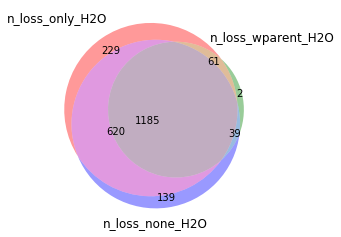

In [10]:
venn_3_f_df(data_df, 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O', 'formula')

In [11]:
### Generate observed dataframe
# Three histograms by formula:
obs_df = generate_obs_df(data_df, 'ds_id')

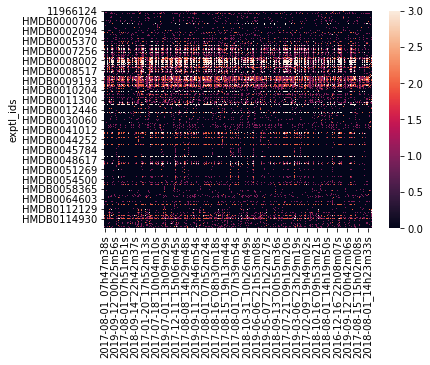

In [12]:
ax = sns.heatmap(obs_df)

/Users/dis/anaconda3/envs/lcenv/lib/python3.6/site-packages/seaborn/matrix.py:624: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by dataset (x)')

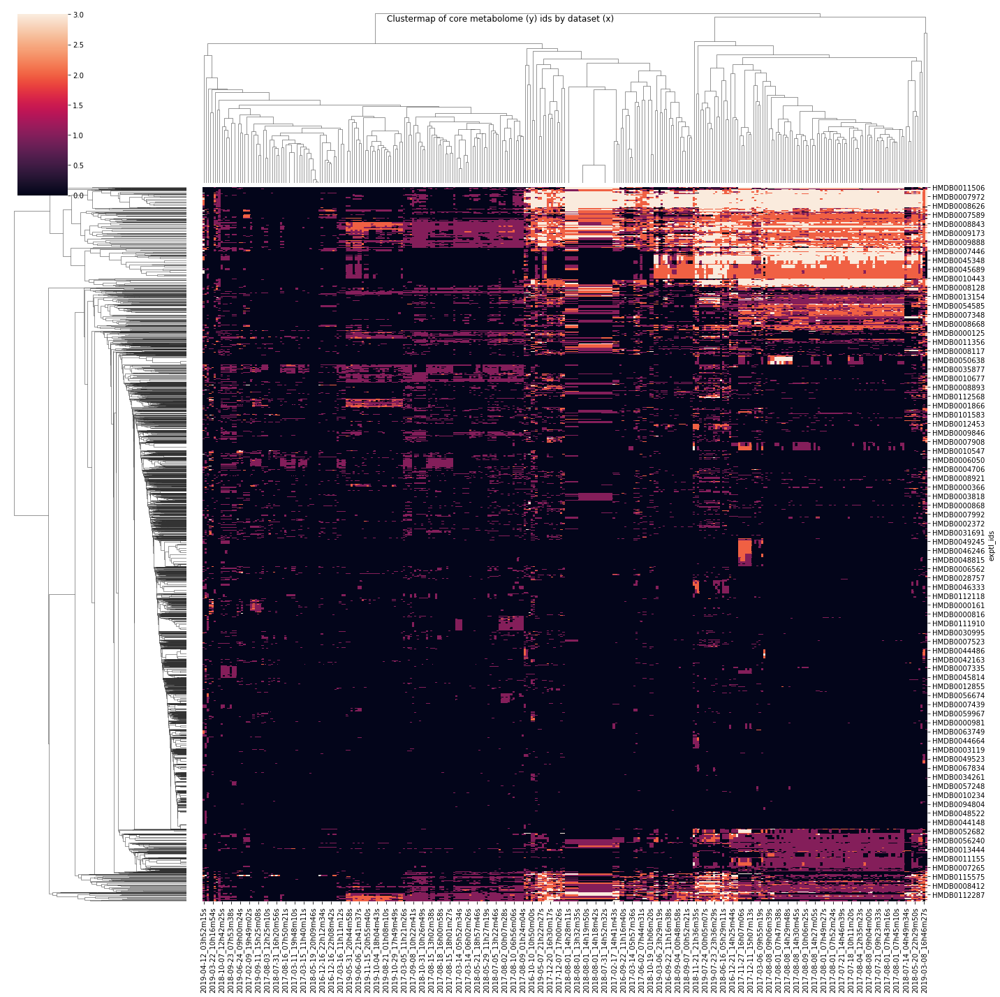

In [13]:
fg = sns.clustermap(obs_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by dataset (x)')

In [14]:
obs_df.to_pickle('obs_df.pickle')

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by group (x)')

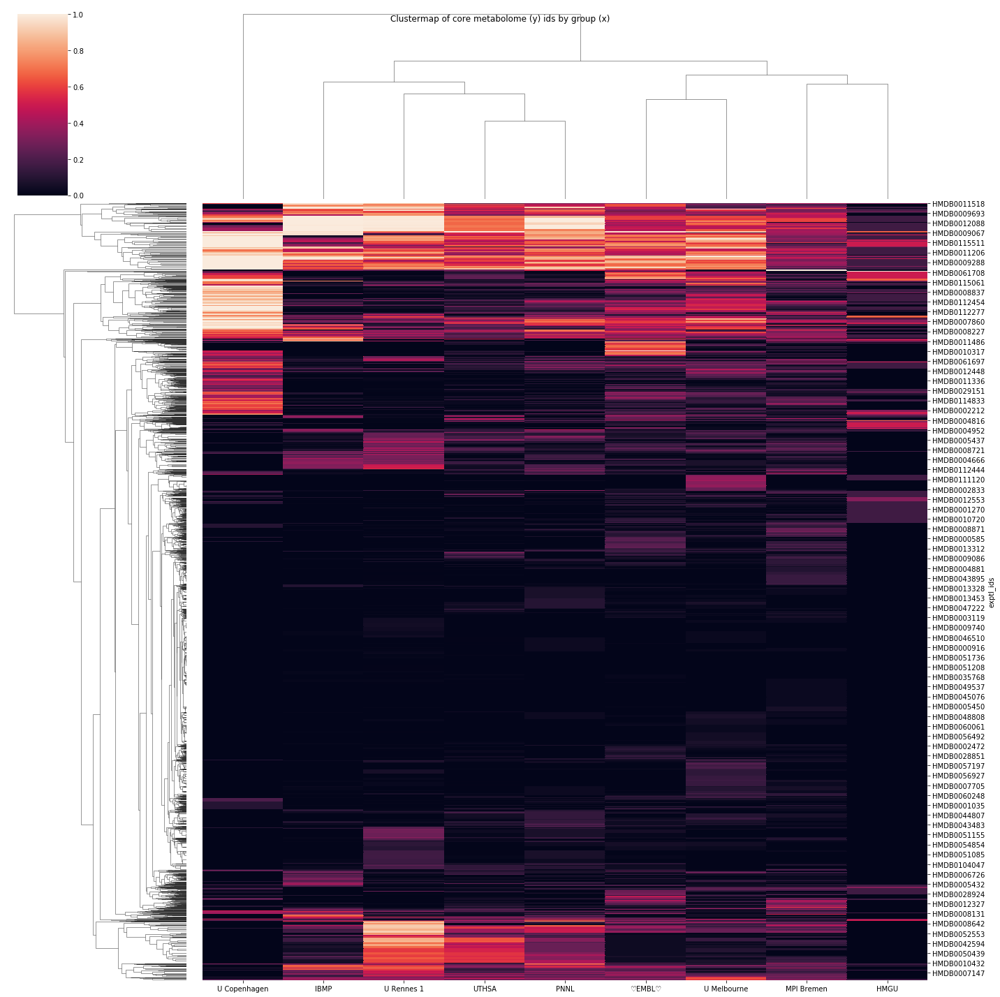

In [14]:
group_df = generate_obs_df(data_df, 'group')
# group_df = normalize_df(group_df) # after next reload
group_df = (group_df - group_df.min()) / (group_df.max() - group_df.min())

fg = sns.clustermap(group_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by group (x)')

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by inst/pol (x)')

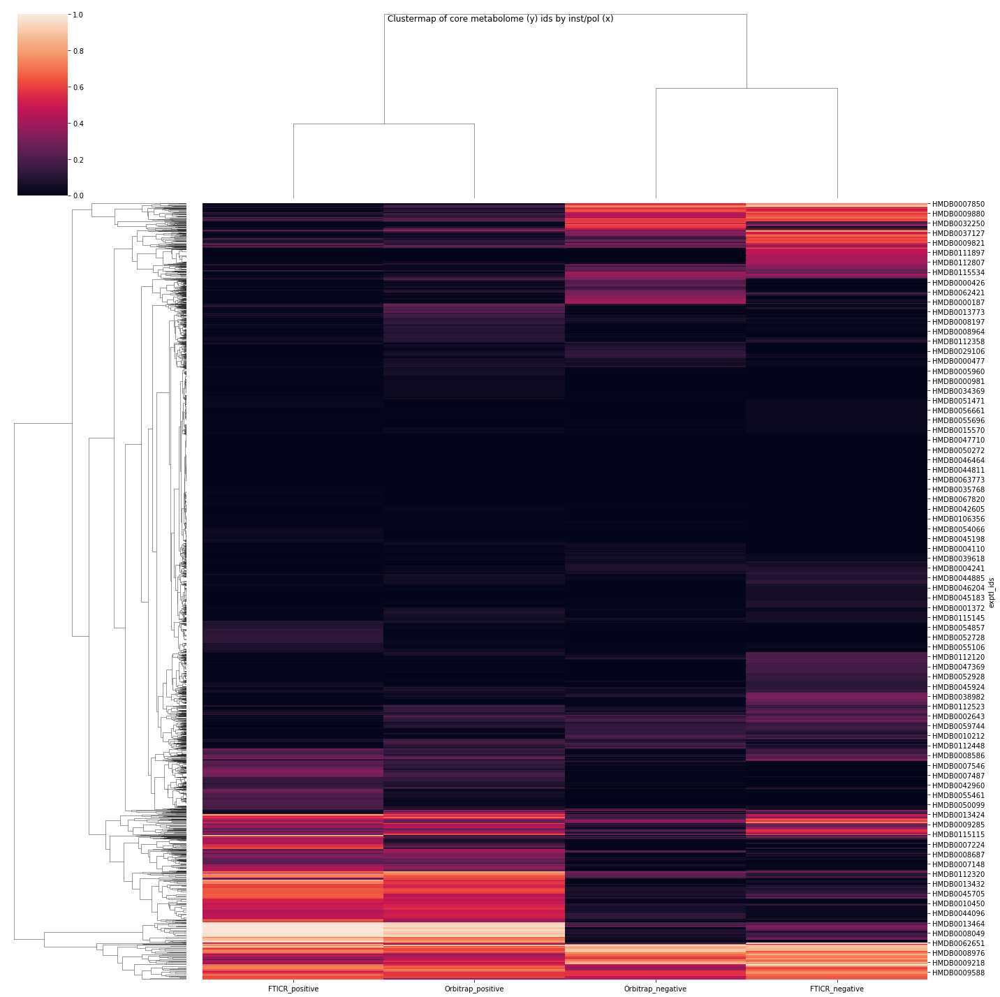

In [16]:
df = generate_obs_df(data_df, 'fourX')
# group_df = normalize_df(group_df) # after next reload
fourX_df = (df - df.min()) / (df.max() - df.min())

fg = sns.clustermap(fourX_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by inst/pol (x)')

Text(0.5, 0.98, 'Clustermap of core metabolome (y) ids by group/inst/pol (x)')

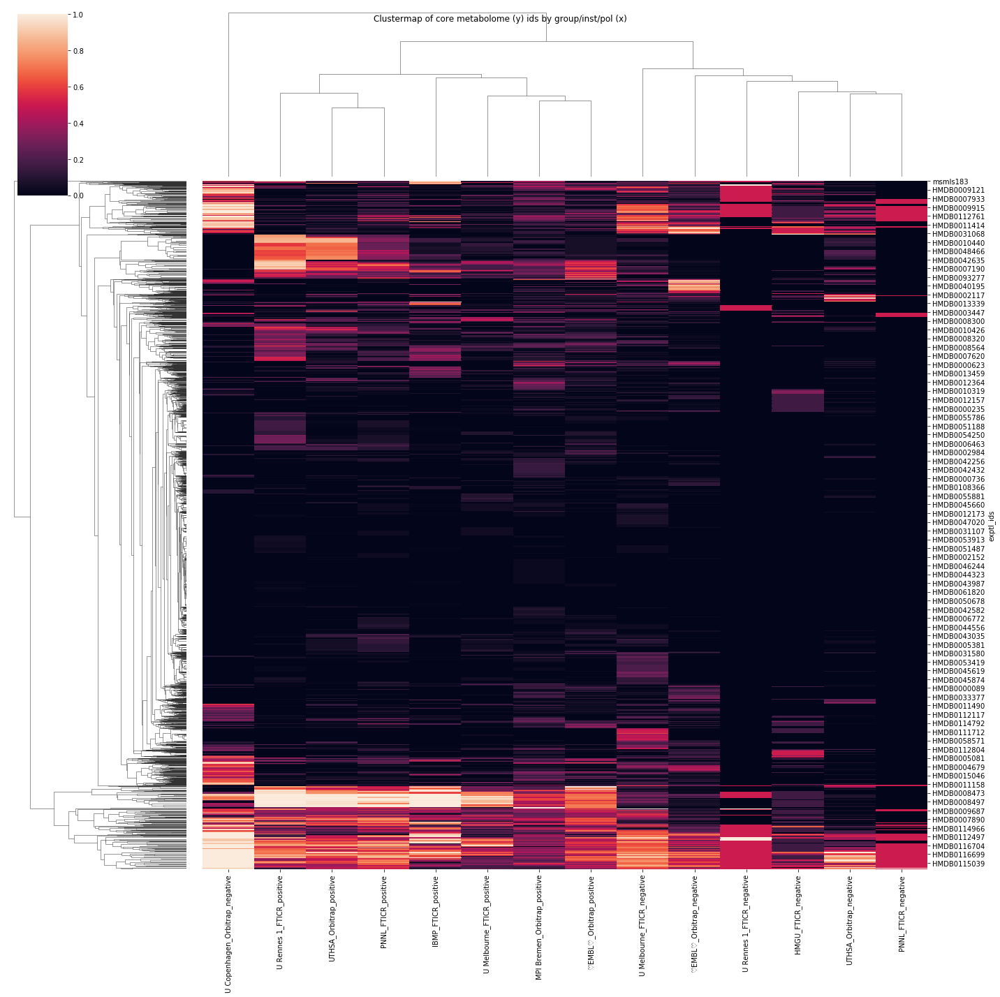

In [15]:
df = generate_obs_df(data_df, 'group_4x')
# group_df = normalize_df(group_df) # after next reload
group_4x_df = (df - df.min()) / (df.max() - df.min())

fg = sns.clustermap(group_4x_df, figsize=(20, 20))
fg.fig.suptitle('Clustermap of core metabolome (y) ids by group/inst/pol (x)')

In [ ]:
# Negative and positve cluster differently, FT and Orbi not so much.
# Should be able to treat as two cases.  Expected result.

In [16]:
# Multiple histogram example
cols = ['formula', 'ds_id']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(1,2))

In [17]:
# Multiple histogram example
# Add combo of all 3x
cols = ['analyzer', 'polarity', 'group']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(3,1))

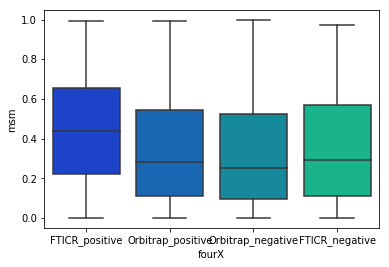

In [19]:
# Groupby boxplot
# Much quicker!
df = data_df[['fourX', 'msm']]
sns.boxplot(x='fourX', y='msm', data=df, palette='winter')

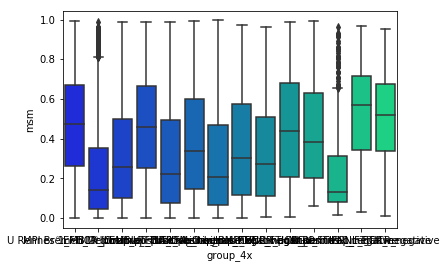

In [20]:
# Groupby boxplot
# Much quicker!
df = data_df[['group_4x', 'msm']]
sns.boxplot(x='group_4x', y='msm', data=df, palette='winter')

In [21]:
df = data_df[['group_4x', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['group_4x']).sum()
#df = df.unstack().fillna(0)
df

,n_loss_only_H2O,n_loss_wparent_H2O,n_loss_none_H2O
group_4x,,,
HMGU_FTICR_negative,426.0,153.0,407.0
IBMP_FTICR_positive,4123.0,2245.0,8523.0
MPI Bremen_Orbitrap_positive,3335.0,1840.0,2476.0
PNNL_FTICR_negative,62.0,32.0,75.0
PNNL_FTICR_positive,2215.0,975.0,2882.0
U Copenhagen_Orbitrap_negative,891.0,1025.0,1812.0
U Melbourne_FTICR_negative,2843.0,1287.0,3328.0
U Melbourne_FTICR_positive,851.0,370.0,1283.0
U Rennes 1_FTICR_negative,66.0,26.0,130.0


In [22]:
df.iplot(kind='bar')

In [23]:
df = df.apply(lambda x: x/x.max(), axis=1)

In [24]:
df.iplot(kind='bar')

In [25]:
# Neutral losses by formula:
#df = data_df[(data_df.polarity=='positive')&((data_df.fdr<0.1)|(data_df.fdr.isna()))]
df = data_df[(data_df.polarity=='positive')&((data_df.fdr<0.2)|(data_df.fdr.isna()))]
df = df[['formula', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['formula']).sum()
fig = df.iplot(kind='bar') # subplots=True, shape=(3,1))

In [26]:
# New function for best fdr filtering, makes sure 1/2 beats threshold.
df = best_df(data_df, 0.05, 'H2O')

df = df[['formula', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['formula']).sum()
fig = df.iplot(kind='bar') # subplots=True, shape=(3,1))

In [27]:
df = data_df[['group_4x', 'ds_id', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['group_4x', 'ds_id']).sum()
df['only'] = df['n_loss_only_H2O'] / (df['n_loss_only_H2O'] + df['n_loss_none_H2O']) 
df = df.drop(columns=['n_loss_only_H2O', 'n_loss_wparent_H2O', 'n_loss_none_H2O']).reset_index()

[Text(0, 0, 'HMGU_FTICR_negative'),
 Text(0, 0, 'IBMP_FTICR_positive'),
 Text(0, 0, 'MPI Bremen_Orbitrap_positive'),
 Text(0, 0, 'PNNL_FTICR_negative'),
 Text(0, 0, 'PNNL_FTICR_positive'),
 Text(0, 0, 'U Copenhagen_Orbitrap_negative'),
 Text(0, 0, 'U Melbourne_FTICR_negative'),
 Text(0, 0, 'U Melbourne_FTICR_positive'),
 Text(0, 0, 'U Rennes 1_FTICR_negative'),
 Text(0, 0, 'U Rennes 1_FTICR_positive'),
 Text(0, 0, 'UTHSA_Orbitrap_negative'),
 Text(0, 0, 'UTHSA_Orbitrap_positive'),
 Text(0, 0, '♡EMBL♡_Orbitrap_negative'),
 Text(0, 0, '♡EMBL♡_Orbitrap_positive')]

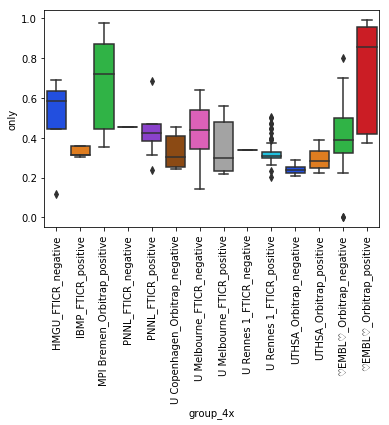

In [28]:
ax = sns.boxplot(x='group_4x', y='only', data=df, palette='bright')
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

[Text(0, 0, 'HMGU_FTICR_negative'),
 Text(0, 0, 'IBMP_FTICR_positive'),
 Text(0, 0, 'MPI Bremen_Orbitrap_positive'),
 Text(0, 0, 'PNNL_FTICR_negative'),
 Text(0, 0, 'PNNL_FTICR_positive'),
 Text(0, 0, 'U Copenhagen_Orbitrap_negative'),
 Text(0, 0, 'U Melbourne_FTICR_negative'),
 Text(0, 0, 'U Melbourne_FTICR_positive'),
 Text(0, 0, 'U Rennes 1_FTICR_negative'),
 Text(0, 0, 'U Rennes 1_FTICR_positive'),
 Text(0, 0, 'UTHSA_Orbitrap_negative'),
 Text(0, 0, 'UTHSA_Orbitrap_positive'),
 Text(0, 0, '♡EMBL♡_Orbitrap_negative'),
 Text(0, 0, '♡EMBL♡_Orbitrap_positive')]

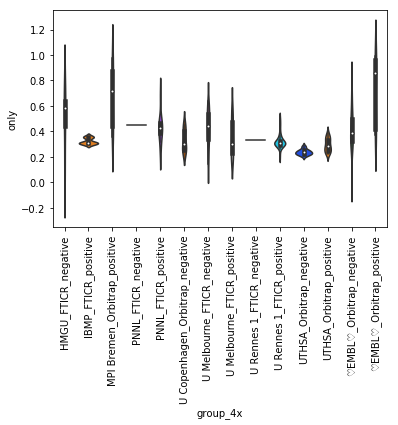

In [29]:
ax = sns.violinplot(x='group_4x', y='only', data=df, palette='bright')
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

In [30]:
df = data_df[['group_4x', 'ds_id', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['group_4x', 'ds_id']).sum()
df['with'] = df['n_loss_wparent_H2O'] / (df['n_loss_wparent_H2O'] + df['n_loss_none_H2O']) 
df = df.drop(columns=['n_loss_only_H2O', 'n_loss_wparent_H2O', 'n_loss_none_H2O']).reset_index()

[Text(0, 0, 'HMGU_FTICR_negative'),
 Text(0, 0, 'IBMP_FTICR_positive'),
 Text(0, 0, 'MPI Bremen_Orbitrap_positive'),
 Text(0, 0, 'PNNL_FTICR_negative'),
 Text(0, 0, 'PNNL_FTICR_positive'),
 Text(0, 0, 'U Copenhagen_Orbitrap_negative'),
 Text(0, 0, 'U Melbourne_FTICR_negative'),
 Text(0, 0, 'U Melbourne_FTICR_positive'),
 Text(0, 0, 'U Rennes 1_FTICR_negative'),
 Text(0, 0, 'U Rennes 1_FTICR_positive'),
 Text(0, 0, 'UTHSA_Orbitrap_negative'),
 Text(0, 0, 'UTHSA_Orbitrap_positive'),
 Text(0, 0, '♡EMBL♡_Orbitrap_negative'),
 Text(0, 0, '♡EMBL♡_Orbitrap_positive')]

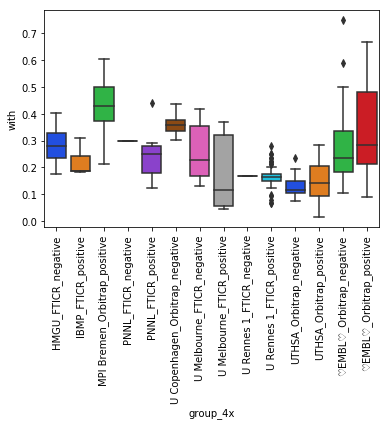

In [31]:
ax = sns.boxplot(x='group_4x', y='with', data=df, palette='bright')
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

In [32]:
# At high FDR
df = best_df(data_df, 0.05, 'H2O')
df = df[['group_4x', 'ds_id', 'n_loss_only_H2O', 'n_loss_wparent_H2O', 
            'n_loss_none_H2O']]
df = df.groupby(['group_4x', 'ds_id']).sum()
df['with'] = df['n_loss_wparent_H2O'] / (df['n_loss_wparent_H2O'] + df['n_loss_none_H2O']) 
df = df.drop(columns=['n_loss_only_H2O', 'n_loss_wparent_H2O', 'n_loss_none_H2O']).reset_index()

[Text(0, 0, 'HMGU_FTICR_negative'),
 Text(0, 0, 'IBMP_FTICR_positive'),
 Text(0, 0, 'MPI Bremen_Orbitrap_positive'),
 Text(0, 0, 'PNNL_FTICR_negative'),
 Text(0, 0, 'PNNL_FTICR_positive'),
 Text(0, 0, 'U Copenhagen_Orbitrap_negative'),
 Text(0, 0, 'U Melbourne_FTICR_negative'),
 Text(0, 0, 'U Melbourne_FTICR_positive'),
 Text(0, 0, 'U Rennes 1_FTICR_negative'),
 Text(0, 0, 'U Rennes 1_FTICR_positive'),
 Text(0, 0, 'UTHSA_Orbitrap_negative'),
 Text(0, 0, 'UTHSA_Orbitrap_positive'),
 Text(0, 0, '♡EMBL♡_Orbitrap_negative'),
 Text(0, 0, '♡EMBL♡_Orbitrap_positive')]

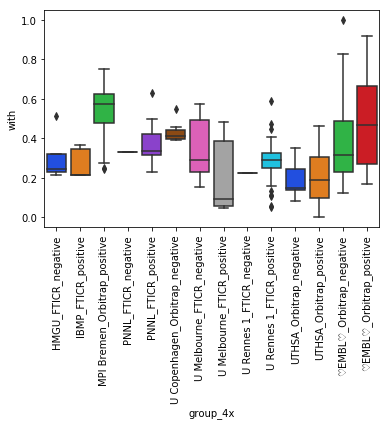

In [33]:
ax = sns.boxplot(x='group_4x', y='with', data=df, palette='bright')
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)

In [ ]:
# EMBL and MPI Bremen use the same system (they have AP-SMALDI10 
# that we had till October)

# Next see:
http://localhost:8888/notebooks/PycharmProjects/neutral_loss/Exploratory_data_analysis_chemical_space.ipynb